<a href="https://colab.research.google.com/github/snicolau/HumanBodyOcclusionMaskEstimation/blob/main/02_AmodalMasksTraining.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MASK OBTENTION

## 0. Load images

In [ ]:
import os
!pip install iglovikov_helper_functions
from iglovikov_helper_functions.utils.image_utils import load_rgb, pad, unpad
from iglovikov_helper_functions.dl.pytorch.utils import tensor_from_rgb_image
import matplotlib.pyplot as plt
from pylab import imshow, imsave

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
folder = '/content/drive/MyDrive/IR/frames'

In [ ]:
!mkdir '/content/movies/'
!cp -av '/content/drive/MyDrive/IR/frames' '/content/movies/'
!mv '/content/movies/frames' '/content/movies/images'

'/content/drive/MyDrive/IR/frames' -> '/content/movies/frames'
'/content/drive/MyDrive/IR/frames/benjamin.png' -> '/content/movies/frames/benjamin.png'
'/content/drive/MyDrive/IR/frames/vlcsnap-2022-03-16-02h16m36s394.png' -> '/content/movies/frames/vlcsnap-2022-03-16-02h16m36s394.png'
'/content/drive/MyDrive/IR/frames/vlcsnap-2022-03-16-02h16m49s685.png' -> '/content/movies/frames/vlcsnap-2022-03-16-02h16m49s685.png'
'/content/drive/MyDrive/IR/frames/cfire.png' -> '/content/movies/frames/cfire.png'
'/content/drive/MyDrive/IR/frames/harry.png' -> '/content/movies/frames/harry.png'
'/content/drive/MyDrive/IR/frames/vlcsnap-2022-03-18-17h14m31s913.png' -> '/content/movies/frames/vlcsnap-2022-03-18-17h14m31s913.png'
'/content/drive/MyDrive/IR/frames/vlcsnap-2022-04-20-19h30m42s701.png' -> '/content/movies/frames/vlcsnap-2022-04-20-19h30m42s701.png'
'/content/drive/MyDrive/IR/frames/vlcsnap-2022-04-20-19h31m00s660.png' -> '/content/movies/frames/vlcsnap-2022-04-20-19h31m00s660.png'
'/conte

In [ ]:
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = load_rgb(os.path.join(folder,filename))
        if img is not None:
            images.append(img)
    return images

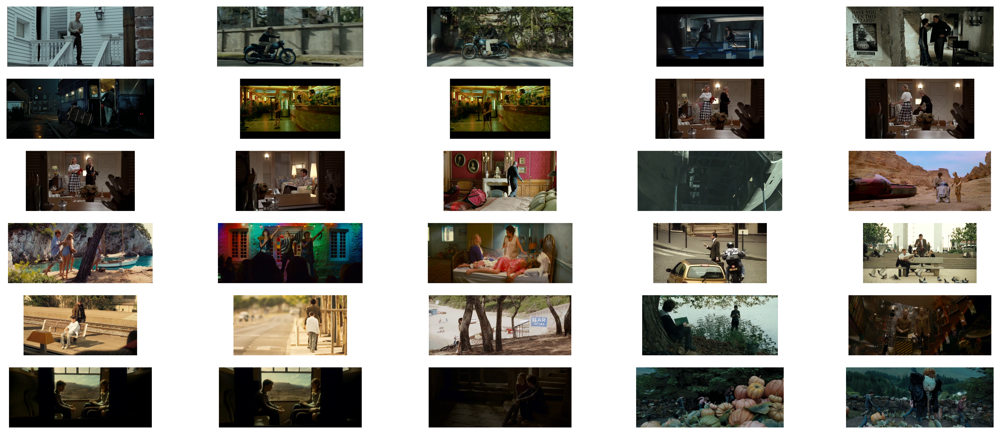

In [ ]:
images = load_images_from_folder(folder)

plt.figure(figsize=(20,10),dpi=400)
columns = 5
for i, image in enumerate(images):
    plt.subplot(len(images) / columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.axis('off')

## 1. Amodal masks

### 2.1. ORCNN in Detectron2

https://github.com/waiyulam/ORCNN/blob/master/INSTALL.md
https://git.wur.nl/blok012/sizecnn/-/tree/master/

In [ ]:
!pip install cython; pip install 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

In [ ]:
!pip install pycocotools==2.0.2

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 13,13
def imshow(img):
    plt.imshow(img[:, :, [2, 1, 0]])
    plt.axis("off")
    plt.show()

#### 2.1.1. Amodal Human Perception dataset

In [ ]:
!gdown https://drive.google.com/uc?id=1rPadar5swN_e-4Qe3VWafHjgtT0s4yc6

Downloading...
From: https://drive.google.com/uc?id=1rPadar5swN_e-4Qe3VWafHjgtT0s4yc6
To: /content/AHP.zip
100% 4.47G/4.47G [00:26<00:00, 170MB/s]


In [ ]:
!unzip AHP.zip -d /content/

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: /content/AHP/train/PseudoParsingAnnotations/obj365_train_000000161832_000.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/openimages_ba165db1569e020f_000.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/openimages_bac35ec9de94f130_010.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/obj365_train_000000535276_001.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/obj365_train_000000171455_003.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/openimages_000000103401_000.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/obj365_train_000000148316_000.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/obj365_train_000000022137_000.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/openimages_3ed9814cf2d12241_000.png  
  inflating: /content/AHP/train/PseudoParsingAnnotations/obj365_train_000000567063_000.png  
  inf

##### a) Convert annotations to JSON

In [ ]:
!git clone https://github.com/chrise96/image-to-coco-json-converter

Cloning into 'image-to-coco-json-converter'...
remote: Enumerating objects: 58, done.
remote: Counting objects: 100% (58/58), done.
remote: Compressing objects: 100% (40/40), done.
remote: Total 58 (delta 12), reused 57 (delta 12), pack-reused 0
Unpacking objects: 100% (58/58), done.


In [ ]:
%cd /content/image-to-coco-json-converter/

/content/image-to-coco-json-converter


In [ ]:
!pip install Shapely==1.7.1
!pip install scikit-image==0.17.2
!pip install Pillow==7.2.0

Traceback (most recent call last):
  File "/usr/local/bin/pip3", line 8, in <module>
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/cli/main.py", line 69, in main
    command = create_command(cmd_name, isolated=("--isolated" in cmd_args))
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/commands/__init__.py", line 91, in create_command
    module = importlib.import_module(module_path)
  File "/usr/lib/python3.7/importlib/__init__.py", line 127, in import_module
    return _bootstrap._gcd_import(name[level:], package, level)
  File "<frozen importlib._bootstrap>", line 1006, in _gcd_import
  File "<frozen importlib._bootstrap>", line 983, in _find_and_load
  File "<frozen importlib._bootstrap>", line 967, in _find_and_load_unlocked
  File "<frozen importlib._bootstrap>", line 677, in _load_unlocked
  File "<frozen importlib._bootstrap_external>", line 728, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "/usr

In [ ]:
import glob

from src.create_annotations import *

# Label ids of the dataset
category_ids = {
    "outlier": 0,
    "person": 1,
}

# Define which colors match which categories in the images
category_colors = {
    "(0, 0, 0)": 0, # Outlier
    "(128, 0, 0)": 1, # Person
}

# Define the ids that are a multiplolygon. In our case: wall, roof and sky
multipolygon_ids = [0,1]

# Get "images" and "annotations" info 
def images_annotations_info(maskpath):
    # This id will be automatically increased as we go
    annotation_id = 0
    image_id = 0
    annotations = []
    images = []

    for mask_image in glob.glob(maskpath + "*.png"):
        # The mask image is *.png but the original image is *.jpg.
        # We make a reference to the original file in the COCO JSON file
        original_file_name = os.path.basename(mask_image).split(".")[0] + ".jpg"

        # Open the image and (to be sure) we convert it to RGB
        mask_image_open = Image.open(mask_image).convert("RGB")
        w, h = mask_image_open.size
        
        # "images" info 
        image = create_image_annotation(original_file_name, w, h, image_id)
        images.append(image)

        sub_masks = create_sub_masks(mask_image_open, w, h)
        for color, sub_mask in sub_masks.items():
            category_id = category_colors[color]

            # "annotations" info
            polygons, segmentations = create_sub_mask_annotation(sub_mask)

            # Check if we have classes that are a multipolygon
            if category_id in multipolygon_ids:
                # Combine the polygons to calculate the bounding box and area
                multi_poly = MultiPolygon(polygons)
                                
                annotation = create_annotation_format(multi_poly, segmentations, image_id, category_id, annotation_id)

                annotations.append(annotation)
                annotation_id += 1
            else:
                for i in range(len(polygons)):
                    # Cleaner to recalculate this variable
                    segmentation = [np.array(polygons[i].exterior.coords).ravel().tolist()]
                    
                    annotation = create_annotation_format(polygons[i], segmentation, image_id, category_id, annotation_id)
                    
                    annotations.append(annotation)
                    annotation_id += 1
        image_id += 1
        print(image_id)
    return images, annotations, annotation_id

#if __name__ == "__main__":
# Get the standard COCO JSON format
coco_format = get_coco_json_format()

for keyword in ["train"]:#, "test"]:
    mask_path = "/content/AHP/{}/Annotations/".format(keyword)
    
    # Create category section
    coco_format["categories"] = create_category_annotation(category_ids)

    # Create images and annotations sections
    coco_format["images"], coco_format["annotations"], annotation_cnt = images_annotations_info(mask_path)

    with open("output/{}.json".format(keyword),"w") as outfile:
        json.dump(coco_format, outfile)
    
    print("Created %d annotations for images in folder: %s" % (annotation_cnt, mask_path))

Created 0 annotations for images in folder: /content/AHP/train/Annotations/


In [ ]:
!cp -r /content/image-to-coco-json-converter/output/train.json /content/drive/MyDrive/OCL/

In [ ]:
import glob

from src.create_annotations import *

# Label ids of the dataset
category_ids = {
    "outlier": 0,
    "person": 1,
}

# Define which colors match which categories in the images
category_colors = {
    "(0, 0, 0)": 0, # Outlier
    "(255, 255, 255)": 1, # Person
}

# Define the ids that are a multiplolygon. In our case: wall, roof and sky
multipolygon_ids = [0,1]

# Get "images" and "annotations" info 
def images_annotations_info(maskpath):
    # This id will be automatically increased as we go
    annotation_id = 0
    image_id = 0
    annotations = []
    images = []

    for mask_image in glob.glob(maskpath + "*.png"):
        # The mask image is *.png but the original image is *.jpg.
        # We make a reference to the original file in the COCO JSON file
        original_file_name = os.path.basename(mask_image).split(".")[0] + ".jpg"

        # Open the image and (to be sure) we convert it to RGB
        mask_image_open = Image.open(mask_image).convert("RGB")
        w, h = mask_image_open.size
        
        # "images" info 
        image = create_image_annotation(original_file_name, w, h, image_id)
        images.append(image)

        sub_masks = create_sub_masks(mask_image_open, w, h)
        for color, sub_mask in sub_masks.items():
            category_id = category_colors[color]

            # "annotations" info
            polygons, segmentations = create_sub_mask_annotation(sub_mask)

            # Check if we have classes that are a multipolygon
            if category_id in multipolygon_ids:
                # Combine the polygons to calculate the bounding box and area
                multi_poly = MultiPolygon(polygons)
                                
                annotation = create_annotation_format(multi_poly, segmentations, image_id, category_id, annotation_id)

                annotations.append(annotation)
                annotation_id += 1
            else:
                for i in range(len(polygons)):
                    # Cleaner to recalculate this variable
                    segmentation = [np.array(polygons[i].exterior.coords).ravel().tolist()]
                    
                    annotation = create_annotation_format(polygons[i], segmentation, image_id, category_id, annotation_id)
                    
                    annotations.append(annotation)
                    annotation_id += 1
        image_id += 1
        print(image_id)
    return images, annotations, annotation_id

#if __name__ == "__main__":
# Get the standard COCO JSON format
coco_format = get_coco_json_format()

for keyword in ["test"]:
    mask_path = "/content/AHP/{}/AmodalMasks/".format(keyword)
    
    # Create category section
    coco_format["categories"] = create_category_annotation(category_ids)

    # Create images and annotations sections
    coco_format["images"], coco_format["annotations"], annotation_cnt = images_annotations_info(mask_path)

    with open("output/{}.json".format(keyword),"w") as outfile:
        json.dump(coco_format, outfile)
    
    print("Created %d annotations for images in folder: %s" % (annotation_cnt, mask_path))

Created 0 annotations for images in folder: /content/AHP/test/AmodalMasks/


In [ ]:
!cp -r /content/image-to-coco-json-converter/output/test.json /content/drive/MyDrive/OCL/

In [ ]:
%cd /content/

/content


In [ ]:
!git clone https://github.com/immersive-limit/coco-manager

Cloning into 'coco-manager'...
remote: Enumerating objects: 8, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 8 (delta 2), reused 5 (delta 0), pack-reused 0
Unpacking objects: 100% (8/8), done.


In [ ]:
!python /content/coco-manager/filter.py --input_json /content/drive/MyDrive/OCL/train.json --output_json /content/drive/MyDrive/OCL/train2.json --categories person

Output path already exists. Overwrite? (y/n) Traceback (most recent call last):
  File "/content/coco-manager/filter.py", line 171, in <module>
    cf.main(args)
  File "/content/coco-manager/filter.py", line 114, in main
    should_continue = input('Output path already exists. Overwrite? (y/n) ').lower()
KeyboardInterrupt
^C


In [ ]:
!python /content/coco-manager/filter.py --input_json /content/drive/MyDrive/OCL/test.json --output_json /content/drive/MyDrive/OCL/test2.json --categories person

Output path already exists. Overwrite? (y/n) Traceback (most recent call last):
  File "/content/coco-manager/filter.py", line 171, in <module>
    cf.main(args)
  File "/content/coco-manager/filter.py", line 114, in main
    should_continue = input('Output path already exists. Overwrite? (y/n) ').lower()
KeyboardInterrupt
^C


##### b) Register dataset

In [ ]:
DatasetCatalog.clear()

In [ ]:
# Register my amodal datasets 
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog
register_coco_instances("AHS_train", {}, "/content/drive/MyDrive/OCL/train2.json", "/content/AHP/train/JPEGImages")
register_coco_instances("AHS_val", {}, "/content/drive/MyDrive/OCL/test2.json", "/content/AHP/test/RGBImages")

In [ ]:
AHS_train_metadata = MetadataCatalog.get("AHS_train")
print(AHS_train_metadata)

AHS_val_metadata = MetadataCatalog.get("AHS_val")
print(AHS_val_metadata)

Metadata(evaluator_type='coco', image_root='/content/AHP/train/JPEGImages', json_file='/content/drive/MyDrive/OCL/train2.json', name='AHS_train')
Metadata(evaluator_type='coco', image_root='/content/AHP/test/RGBImages', json_file='/content/drive/MyDrive/OCL/test2.json', name='AHS_val')


In [ ]:
dataset_dicts_train = DatasetCatalog.get("AHS_train")
dataset_dicts_val = DatasetCatalog.get("AHS_val")

[06/19 18:36:36 d2.data.datasets.coco]: Loading /content/drive/MyDrive/OCL/train2.json takes 3.30 seconds.
[06/19 18:36:36 d2.data.datasets.coco]: Loaded 56599 images in COCO format from /content/drive/MyDrive/OCL/train2.json
[06/19 18:36:38 d2.data.datasets.coco]: Loaded 56 images in COCO format from /content/drive/MyDrive/OCL/test2.json


/content/AHP/train/JPEGImages/openimages_78f37d3d5a68fa49_000.jpg


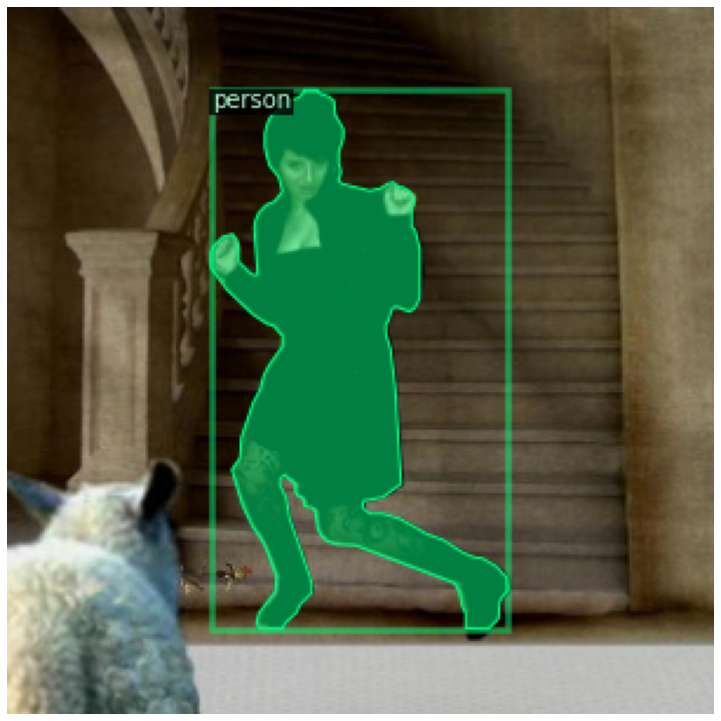

/content/AHP/train/JPEGImages/openimages_000000281952_000.jpg


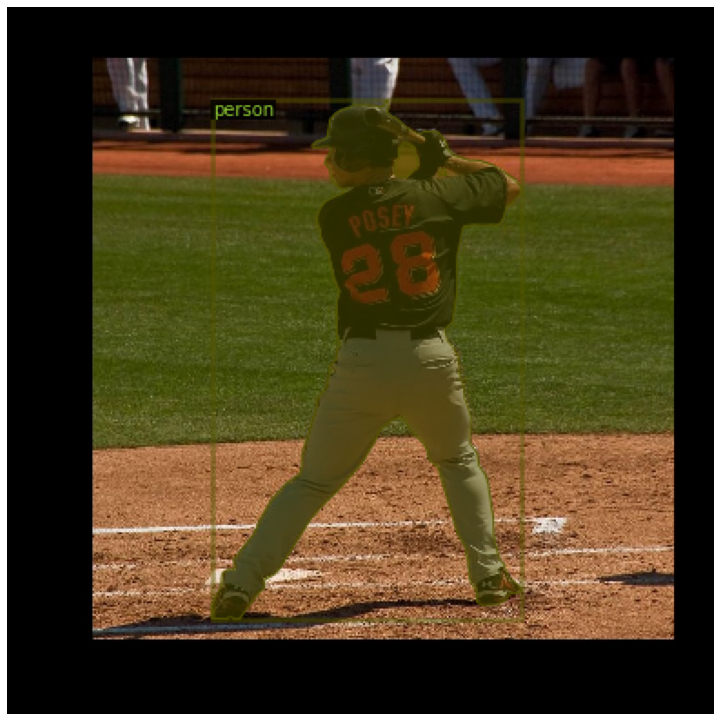

/content/AHP/train/JPEGImages/obj365_train_000000563118_000.jpg


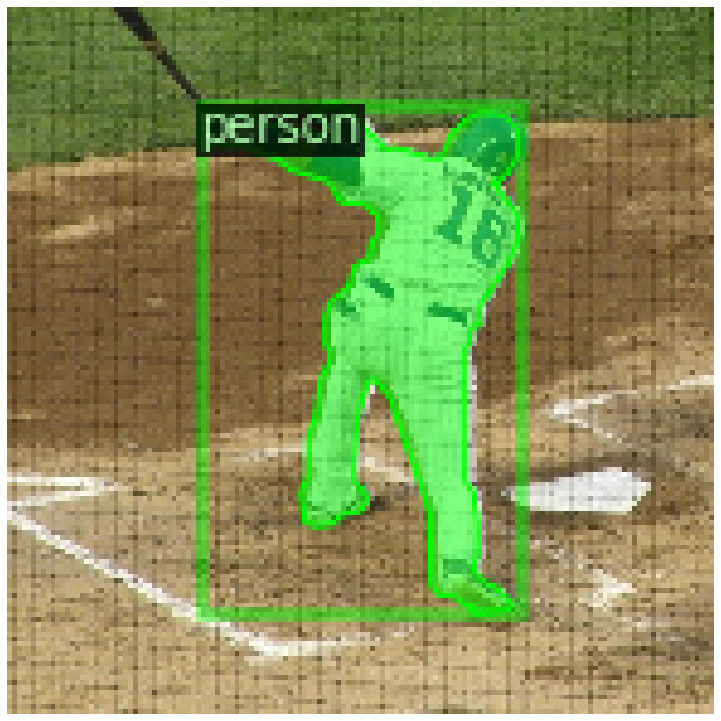

In [ ]:
 for d in random.sample(dataset_dicts_train, 3):
    img = cv2.imread(d["file_name"])
    print(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=AHS_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    imshow(vis.get_image()[:, :, ::-1])

#### 2.1.2. SAIL-VOS dataset

In [ ]:
%cd /content/

In [ ]:
!mkdir /content/SAILVOS
%cd /content/SAILVOS

In [ ]:
!unzip /content/drive/MyDrive/OCL/sailvos_val.zip

In [ ]:
# Register my amodal datasets 
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog
register_coco_instances("SAILVOS_train", {}, "/content/drive/MyDrive/OCL/valid2.json", "/content/SAILVOS")

In [ ]:
SAILVOS_train_metadata = MetadataCatalog.get("SAILVOS_train")
print(SAILVOS_train_metadata)

In [ ]:
dataset2_dicts_train = DatasetCatalog.get("SAILVOS_train")

In [ ]:
 for d in random.sample(dataset2_dicts_train, 3):
    img = cv2.imread(d["file_name"])
    print(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=SAILVOS_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    imshow(vis.get_image()[:, :, ::-1])

#### 2.1.3. OCRNN Training

In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os
import cv2
import random
# from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog,MetadataCatalog
from detectron2.engine import DefaultTrainer
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 10,10
def imshow(img):
    plt.imshow(img[:, :, [2, 1, 0]])
    plt.axis("off")
    plt.show()

In [ ]:
import os
import numpy as np
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("SAILVOS_train",)
cfg.DATASETS.TEST = ("SAILVOS_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.INPUT.MASK_FORMAT = "bitmask"
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.SOLVER.BASE_LR = 0.005  # pick a good LR
#cfg.SOLVER.STEPS = (6000,8000)
cfg.SOLVER.MAX_ITER = 1200 
cfg.VIS_PERIOD = 500
cfg.OUTPUT_DIR = "orcnnCheckpoint"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.9  # set the testing threshold for this model
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[06/16 01:15:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Some model parameters or buffers are not found in the checkpoint:
backbone.fpn_lateral2.{bias, weight}
backbone.fpn_lateral3.{bias, weight}
backbone.fpn_lateral4.{bias, weight}
backbone.fpn_lateral5.{bias, weight}
backbone.fpn_output2.{bias, weight}
backbone.fpn_output3.{bias, weight}
backbone.fpn_output4.{bias, weight}
backbone.fpn_output5.{bias, weight}
proposal_generator.rpn_head.anchor_deltas.{bias, weight}
proposal_generator.rpn_head.conv.{bias, weight}
proposal_generator.rpn_head.objectness_logits.{bias, weight}
roi_heads.box_head.fc1.{bias, weight}
roi_heads.box_head.fc2.{bias, weight}
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.deconv.{bias, weight}
roi_heads.mask_head.mask_fcn1.{bias, weight}
roi_heads.mask_head.mask_fcn2.{bias, weight}
roi_heads.mask_head.mask_fcn3.{bias, weight}
roi_heads.mask_head.mask_fcn4.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}
The checkpoint state_dict contains 

[06/16 01:15:11 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/data/detection_utils.py:433: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  torch.stack([torch.from_numpy(np.ascontiguousarray(x)) for x in masks])
/usr/local/lib/python3.7/dist-packages/detectron2/data/detection_utils.py:433: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This ty

[06/16 01:15:33 d2.utils.events]:  eta: 0:55:45  iter: 19  total_loss: 1.614  loss_cls: 0.193  loss_box_reg: 0.0008108  loss_mask: 0.6924  loss_rpn_cls: 0.6947  loss_rpn_loc: 0.03706  time: 1.0958  data_time: 0.0332  lr: 9.9905e-05  max_mem: 13772M
[06/16 01:15:56 d2.utils.events]:  eta: 0:55:29  iter: 39  total_loss: 1.328  loss_cls: 0.02641  loss_box_reg: 0.002761  loss_mask: 0.6878  loss_rpn_cls: 0.585  loss_rpn_loc: 0.03805  time: 1.1129  data_time: 0.0240  lr: 0.0001998  max_mem: 13772M
[06/16 01:16:19 d2.utils.events]:  eta: 0:55:26  iter: 59  total_loss: 1.234  loss_cls: 0.0549  loss_box_reg: 0.02668  loss_mask: 0.6819  loss_rpn_cls: 0.3708  loss_rpn_loc: 0.04714  time: 1.1232  data_time: 0.0148  lr: 0.0002997  max_mem: 13772M
[06/16 01:16:41 d2.utils.events]:  eta: 0:54:55  iter: 79  total_loss: 1.063  loss_cls: 0.08397  loss_box_reg: 0.05728  loss_mask: 0.6802  loss_rpn_cls: 0.1941  loss_rpn_loc: 0.03815  time: 1.1191  data_time: 0.0124  lr: 0.00039961  max_mem: 13772M
[06/16 

In [ ]:
!cp -r /content/orcnnCheckpoint/model_final.pth /content/drive/MyDrive/OCL/model_final7.pth

In [ ]:
import os
#cfg.DATASETS.TEST = ("AHS_val",)
cfg.OUTPUT_DIR = "orcnnCheckpoint"
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.WEIGHTS =  model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)

In [ ]:
out_vec = []

for image in images:
    outputs = predictor(image)

    v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    out = out.get_image()[:, :, ::-1]
    
    out_vec.append(out)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


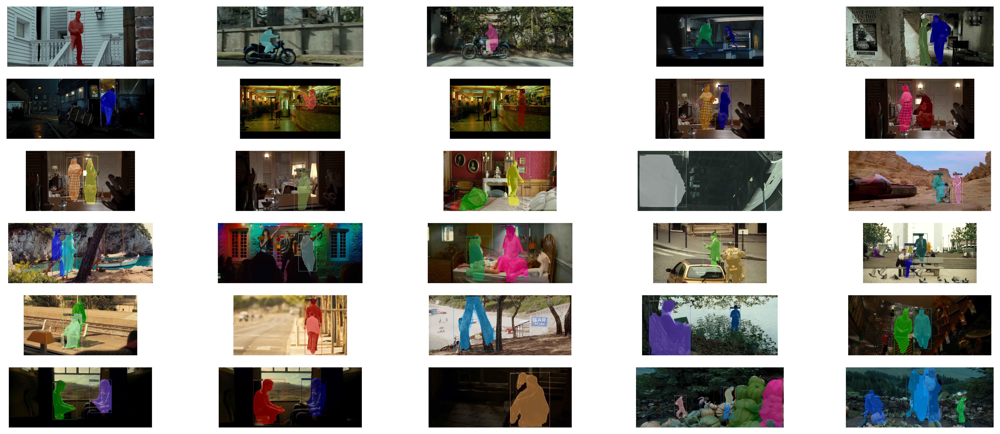

In [ ]:
plt.figure(figsize=(20,10),dpi=400)
columns = 5
for i, image in enumerate(out_vec):
    plt.subplot(len(out_vec) / columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.axis('off')